In [46]:
%matplotlib inline

In [1]:
import jax
from jax.config import config
config.update("jax_enable_x64", True)

2022-12-20 16:29:14.700076: W external/org_tensorflow/tensorflow/stream_executor/platform/default/dso_loader.cc:64] Could not load dynamic library 'libcudart.so.11.0'; dlerror: libcudart.so.11.0: cannot open shared object file: No such file or directory
2022-12-20 16:29:15.711273: W external/org_tensorflow/tensorflow/stream_executor/platform/default/dso_loader.cc:64] Could not load dynamic library 'libcudart.so.11.0'; dlerror: libcudart.so.11.0: cannot open shared object file: No such file or directory
2022-12-20 16:29:15.754907: W external/org_tensorflow/tensorflow/stream_executor/platform/default/dso_loader.cc:64] Could not load dynamic library 'libcudart.so.11.0'; dlerror: libcudart.so.11.0: cannot open shared object file: No such file or directory


In [2]:
import scanpy as sc
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
import moscot
from moscot.problems.time import TemporalProblem
import moscot.plotting as mpl
import pandas as pd
import os

sc.set_figure_params(scanpy=True, dpi=80, dpi_save=200)

import mplscience

mplscience.available_styles()
mplscience.set_style(reset_current=True)
plt.rcParams['legend.scatterpoints'] = 1 

2022-12-20 16:29:24.836883: W external/org_tensorflow/tensorflow/stream_executor/platform/default/dso_loader.cc:64] Could not load dynamic library 'libcuda.so.1'; dlerror: libcuda.so.1: cannot open shared object file: No such file or directory
2022-12-20 16:29:24.838028: W external/org_tensorflow/tensorflow/stream_executor/cuda/cuda_driver.cc:263] failed call to cuInit: UNKNOWN ERROR (303)


['default', 'despine']


/home/icb/dominik.klein/miniconda3/envs/jax_gpu3/lib/python3.8/site-packages/docrep/decorators.py:43: SyntaxWarning: 'alpha_transparency' is not a valid key!
  doc = func(self, args[0].__doc__, *args[1:], **kwargs)


In [3]:
#adata = sc.read("/lustre/groups/ml01/workspace/moscot_paper/pancreas/pancreas_multiome_2022_processed.h5ad")

In [3]:
#adata.shape

In [4]:
output_dir = "."

In [5]:
tp0 = TemporalProblem.load("/lustre/groups/ml01/workspace/moscot_paper/pancreas/JASPAR_TemporalProblem.pkl")

In [6]:
#order_celltypes = ['Ngn3 low', 'Ngn3 high cycling', 'Ngn3 high', 'Eps. progenitors', 'Fev+', 'Fev+ Alpha', 
#                   'Fev+ Beta', 'Fev+ Delta', 'Alpha', 'Beta', 'Delta', 'Epsilon']

In [7]:
color_dict = { 'Prlf. Ductal': '#f7b6d2', 'Ductal': '#d62728', 'Imm. Acinar': '#ffbb78', 'Mat. Acinar': '#98df8a',
    'Alpha': '#1f77b4', 'Beta': '#ff7f0e', 'Delta': '#279e68', 'Eps. progenitors': '#aa40fc', 'Epsilon': '#8c564b',
       'Fev+': '#e377c2', 'Fev+ Alpha': '#b5bd61', 'Fev+ Beta': '#aec7e8', 'Fev+ Delta': '#aec7e8', 'Fev+ Delta,0': '#ffbb78', 'Fev+ Delta,1':'#98df8a',
        'Fev+ Delta,2': '#17becf', 'Ngn3 high cycling': '#aec7e8',
        'Ngn3 high,0': '#ff9896', 'Ngn3 high,1':'#f0b98d', 'Ngn3 low': '#c5b0d5'
}

In [8]:
#tp0.adata.obs["refinement"] = tp0.adata.obs["refinement"].astype("category")
#tp0.adata.uns["refinement_colors"] = [color_dict[ct] for ct in tp0.adata.obs["refinement"].cat.categories]

In [11]:
chromvar_features = [col for col in tp0.adata.obs.columns if col.startswith("MA")]

In [10]:
tp0.pull(14.5, 15.5, data="celltype", subset="Delta", key_added="Delta_pull")

In [12]:
delta_drivers = tp0.compute_feature_correlation(obs_key="Delta_pull", features=chromvar_features)

In [34]:
delta_drivers.head(10)

,Delta_pull_corr,Delta_pull_pval,Delta_pull_qval,Delta_pull_ci_low,Delta_pull_ci_high
MA1608.1,0.157194,4.339876e-53,3.237548e-50,0.137377,0.176884
MA0124.2,0.108395,6.327464e-26,2.360144e-23,0.088335,0.128366
MA0122.3,0.101946,4.228453e-23,4.908026e-21,0.081861,0.121948
MA0914.1,0.097949,1.948049e-21,1.321131e-19,0.077850,0.117969
MA0875.1,0.089145,5.220681e-18,1.622762e-16,0.069016,0.109202
MA1496.1,0.077655,5.117065e-14,1.060370e-12,0.057492,0.097755
MA0748.2,0.072601,1.963102e-12,3.183640e-11,0.052425,0.092718
MA0672.1,0.071604,3.917140e-12,6.087889e-11,0.051425,0.091725
MA1530.1,0.071274,4.916850e-12,7.335940e-11,0.051094,0.091395
MA0885.1,0.070003,1.165961e-11,1.641145e-10,0.049820,0.090129


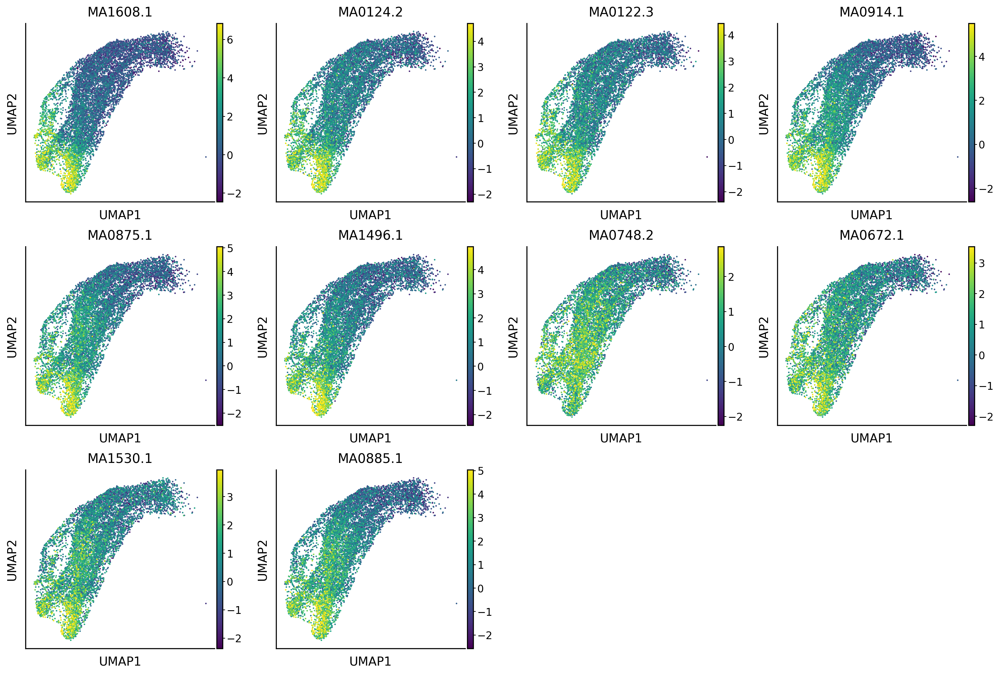

In [14]:
sc.pl.umap(tp0.adata, color=delta_drivers.index[:10], vmin="p01", vmax="p99")

In [ ]:
# MA0875.1 = "BARX1" of homo sapiens, 'Bard1' exists, what is this

In [44]:
[el for el in tp0.adata.var_names if el.startswith("Isl")]

['Islr', 'Isl1']

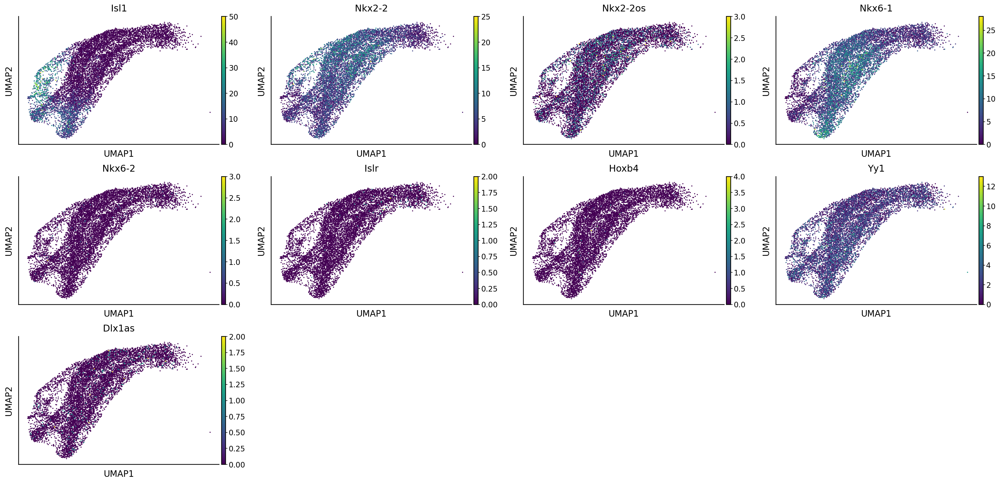

In [47]:
sc.pl.umap(tp0.adata, color=["Isl1", 'Nkx2-2', 'Nkx2-2os', 'Nkx6-1', 'Nkx6-2', 'Islr', 'Hoxb4', 'Yy1', 'Dlx1as'])

In [15]:
tp0.pull(14.5, 15.5, data="celltype", subset="Beta", key_added="Beta_pull")

In [76]:
beta_drivers = tp0.compute_feature_correlation(obs_key="Beta_pull", features=chromvar_features, annotation={"celltype": ["Fev+ Alpha"]})

In [77]:
beta_drivers.head(10)

,Beta_pull_corr,Beta_pull_pval,Beta_pull_qval,Beta_pull_ci_low,Beta_pull_ci_high
MA1608.1,0.262798,2.399457e-08,0.000018,0.172841,0.348407
MA0124.2,0.234764,7.024161e-07,0.000151,0.143706,0.321881
MA0788.1,0.233495,8.104056e-07,0.000151,0.142391,0.320676
MA0644.1,0.226687,1.720251e-06,0.000257,0.135341,0.314212
MA0914.1,0.222506,2.699155e-06,0.000336,0.131016,0.310238
MA0784.1,0.215506,5.625231e-06,0.000599,0.123783,0.303578
MA0661.1,0.209993,9.858412e-06,0.000760,0.118092,0.298326
MA0713.1,0.209438,1.042224e-05,0.000760,0.117520,0.297798
MA0894.1,0.208772,1.113993e-05,0.000760,0.116833,0.297163
MA0707.1,0.208711,1.120752e-05,0.000760,0.116770,0.297105


In [78]:
beta_drivers.loc["MA0674.1"]

Beta_pull_corr       0.163334
Beta_pull_pval       0.000632
Beta_pull_qval       0.007727
Beta_pull_ci_low     0.070177
Beta_pull_ci_high    0.253667
Name: MA0674.1, dtype: float64

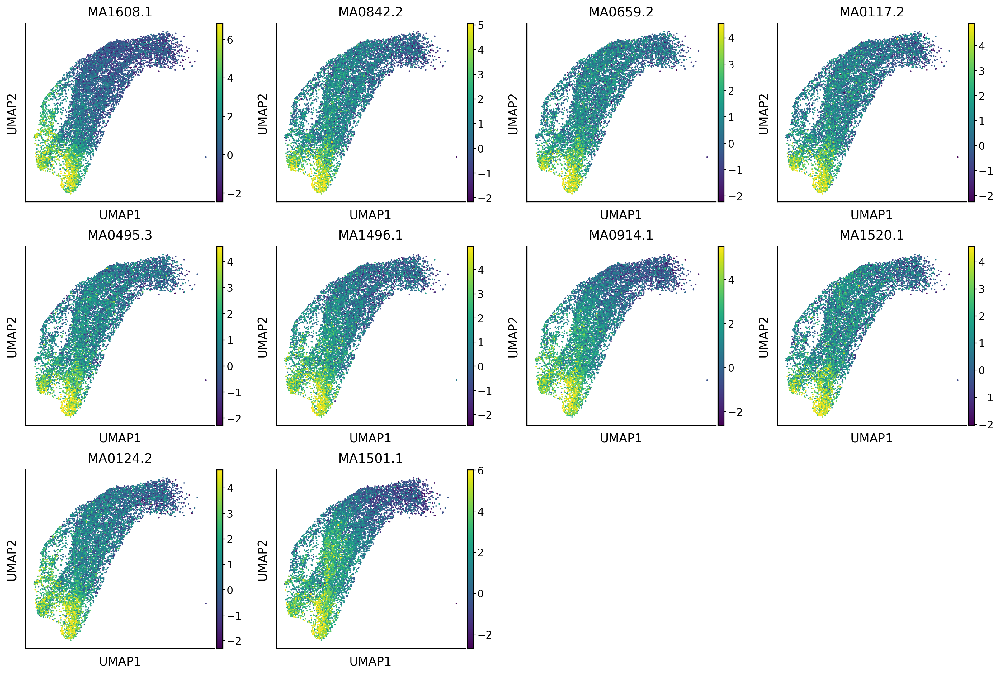

In [20]:
sc.pl.umap(tp0.adata, color=beta_drivers.index[:10], vmin="p01", vmax="p99")

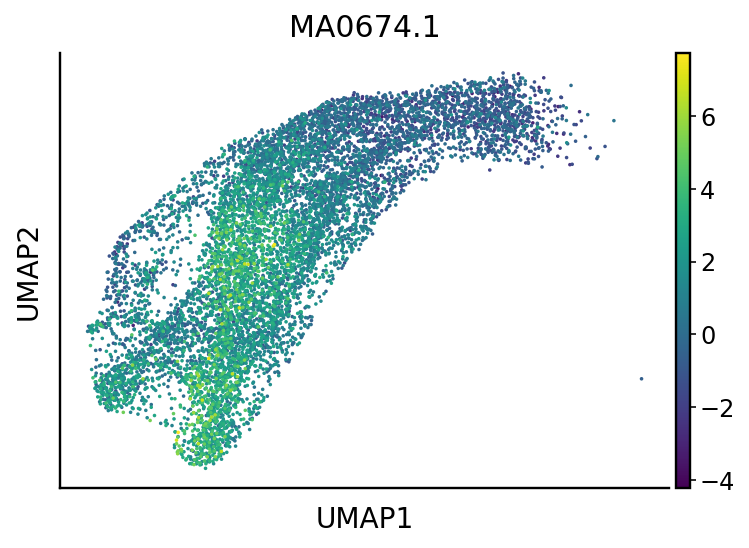

In [79]:
sc.pl.umap(tp0.adata, color="MA0674.1")

In [80]:
[el for el in tp0.adata.var_names if el.startswith("Maf")]

['Mafb', 'Mafk', 'Maf', 'Mafg', 'Mafa', 'Maf1', 'Maff']

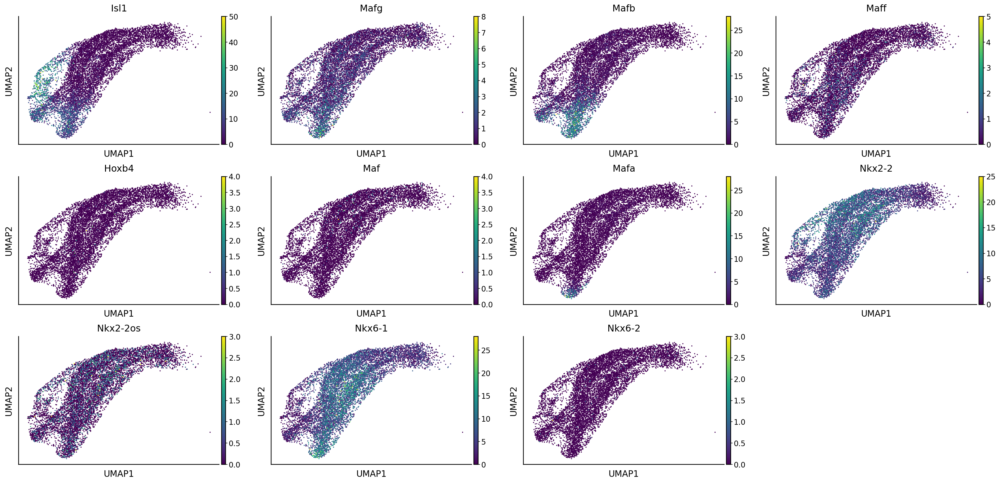

In [81]:
sc.pl.umap(tp0.adata, color=["Isl1", "Mafg", "Mafb", "Maff", "Hoxb4", "Maf", "Mafa", 'Nkx2-2', 'Nkx2-2os', 'Nkx6-1', 'Nkx6-2'])

In [21]:
tp0.pull(14.5, 15.5, data="celltype", subset="Alpha", key_added="Alpha_pull")

In [22]:
alpha_drivers = tp0.compute_feature_correlation(obs_key="Alpha_pull", features=chromvar_features)

In [58]:
alpha_drivers.head(10)

,Alpha_pull_corr,Alpha_pull_pval,Alpha_pull_qval,Alpha_pull_ci_low,Alpha_pull_ci_high
MA0047.3,0.355862,6.431858e-284,4.798166e-281,0.338045,0.373424
MA0148.4,0.342492,2.477072e-261,9.239477e-259,0.324489,0.360247
MA1608.1,0.339871,4.838447e-257,1.203161e-254,0.321833,0.357663
MA0042.2,0.338966,1.433295e-255,1.336548e-253,0.320915,0.356770
MA0033.2,0.338966,1.433295e-255,1.336548e-253,0.320915,0.356770
MA0850.1,0.338966,1.433295e-255,1.336548e-253,0.320915,0.356770
MA0849.1,0.338966,1.433295e-255,1.336548e-253,0.320915,0.356770
MA0848.1,0.338966,1.433295e-255,1.336548e-253,0.320915,0.356770
MA1683.1,0.336967,2.431520e-252,2.015460e-250,0.318890,0.354800
MA1103.2,0.332748,1.322988e-245,9.869490e-244,0.314615,0.350639


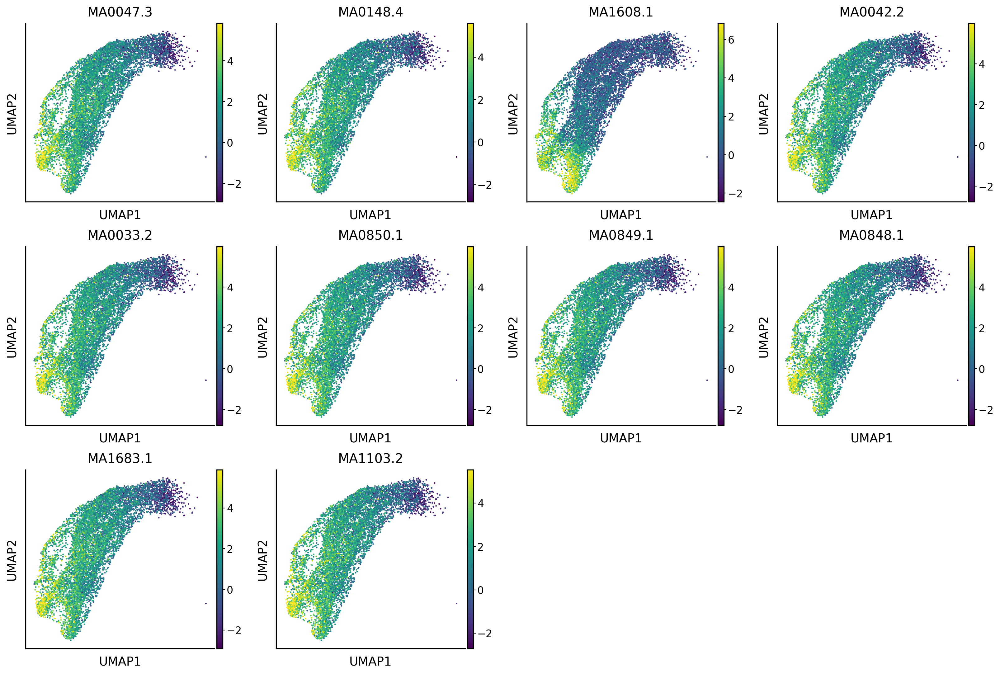

In [24]:
sc.pl.umap(tp0.adata, color=alpha_drivers.index[:10], vmin="p01", vmax="p99")

In [82]:
[el for el in tp0.adata.var_names if el.startswith("Foxa1")]

[]

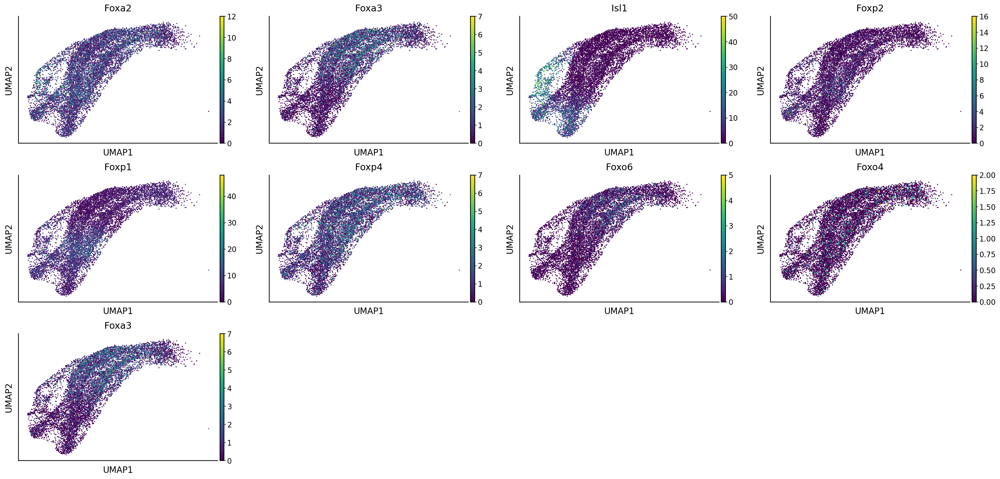

In [68]:
sc.pl.umap(tp0.adata, color=["Foxa2", "Foxa3", "Isl1", 'Foxp2', 'Foxp1', 'Foxp4', 'Foxo6', 'Foxo4', 'Foxa3'])

In [25]:
tp0.pull(14.5, 15.5, data="celltype", subset="Epsilon", key_added="Epsilon_pull")

In [26]:
eps_drivers = tp0.compute_feature_correlation(obs_key="Epsilon_pull", features=chromvar_features)

In [27]:
eps_drivers

,Epsilon_pull_corr,Epsilon_pull_pval,Epsilon_pull_qval,Epsilon_pull_ci_low,Epsilon_pull_ci_high
MA0845.1,0.167606,3.050646e-60,2.275782e-57,0.147854,0.187224
MA0847.2,0.166913,9.460054e-60,3.528600e-57,0.147157,0.186536
MA0846.1,0.162924,5.772127e-57,1.435336e-54,0.143143,0.182575
MA0032.2,0.160967,1.263282e-55,2.356020e-53,0.141174,0.180632
MA1487.1,0.153816,7.131461e-51,1.064014e-48,0.133980,0.173529
...,...,...,...,...,...
MA0621.1,-0.100364,1.961831e-22,4.573517e-21,-0.120373,-0.080273
MA0046.2,-0.101629,5.764547e-23,1.387210e-21,-0.121632,-0.081543
MA0153.2,-0.109733,1.559164e-26,3.877120e-25,-0.129698,-0.089679
MA0598.3,-0.110487,7.028042e-27,1.807903e-25,-0.130449,-0.090436


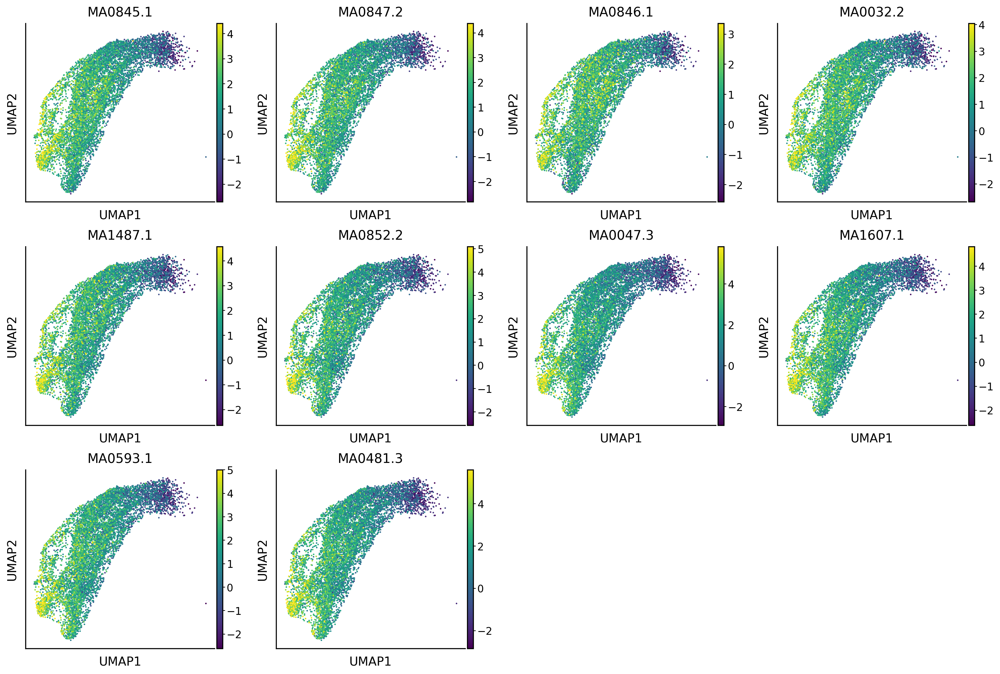

In [28]:
sc.pl.umap(tp0.adata, color=eps_drivers.index[:10], vmin="p01", vmax="p99")

In [29]:
eps_drivers = tp0.compute_feature_correlation(obs_key="Epsilon_pull", features=chromvar_features, annotation={"celltype": ["Epsilon", "Alpha", "Delta", "Ngn3 high", "Fev+ Delta"]})

In [30]:
eps_drivers

,Epsilon_pull_corr,Epsilon_pull_pval,Epsilon_pull_qval,Epsilon_pull_ci_low,Epsilon_pull_ci_high
MA1608.1,0.233216,1.482697e-61,1.106092e-58,0.206449,0.259635
MA0845.1,0.200164,2.219271e-45,8.277881e-43,0.173016,0.227008
MA0032.2,0.185497,4.492979e-39,1.117254e-36,0.158200,0.212510
MA0847.2,0.184458,1.200710e-38,2.239324e-36,0.157151,0.211482
MA1607.1,0.176253,2.291590e-35,2.849211e-33,0.148869,0.203367
...,...,...,...,...,...
MA1642.1,-0.148470,1.965086e-25,4.581106e-24,-0.175858,-0.120853
MA1472.1,-0.148480,1.951498e-25,4.581106e-24,-0.175867,-0.120863
MA1467.1,-0.155150,1.171377e-27,3.236471e-26,-0.182475,-0.127585
MA0046.2,-0.159380,4.042052e-29,2.010247e-27,-0.186665,-0.131850


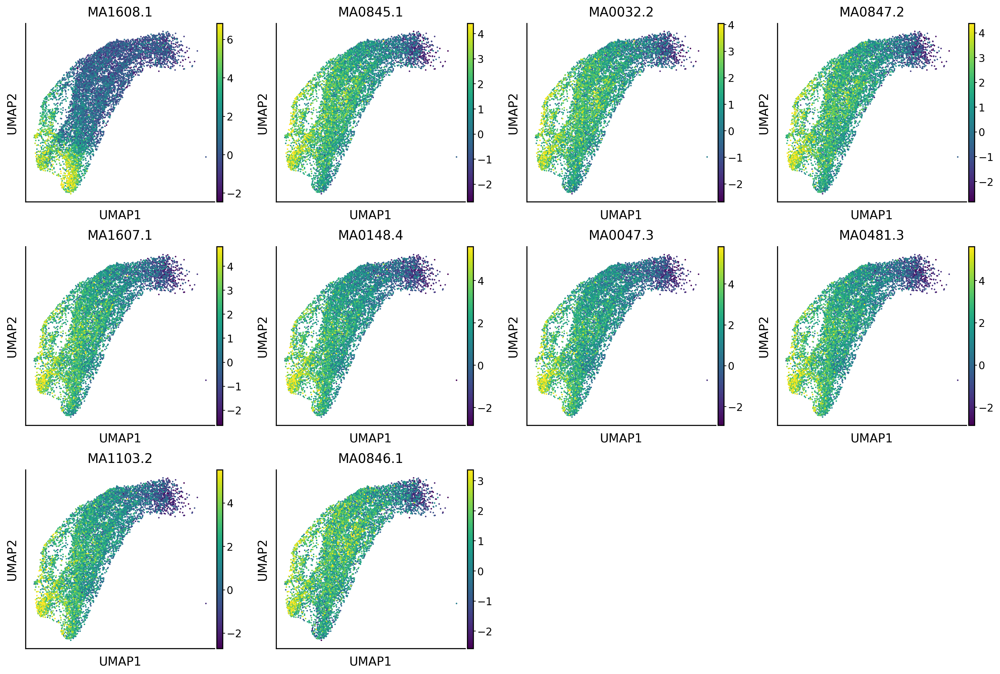

In [31]:
sc.pl.umap(tp0.adata, color=eps_drivers.index[:10], vmin="p01", vmax="p99")

In [37]:
tp0.pull(14.5, 15.5, data="celltype", subset=["Epsilon", "Delta", "Fev+ Delta", "Eps. progenitors"], key_added="eps-delta")

In [38]:
eps_delta_drivers = tp0.compute_feature_correlation(obs_key="eps-delta", features=chromvar_features, annotation={"celltype": ["Ngn3 high", "Eps. progenitors"]})

In [39]:
eps_delta_drivers

,eps-delta_corr,eps-delta_pval,eps-delta_qval,eps-delta_ci_low,eps-delta_ci_high
MA1608.1,0.225873,5.172973e-49,3.859038e-46,0.196628,0.254716
MA1487.1,0.212747,1.633433e-43,6.092705e-41,0.183337,0.241776
MA0148.4,0.211860,3.725036e-43,9.262923e-41,0.182440,0.240902
MA0848.1,0.202883,1.271734e-39,1.185892e-37,0.173355,0.232046
MA0033.2,0.202883,1.271734e-39,1.185892e-37,0.173355,0.232046
...,...,...,...,...,...
MA0643.1,-0.101714,6.375240e-11,1.358837e-09,-0.131907,-0.071332
MA0592.3,-0.103397,3.061103e-11,6.919948e-10,-0.133578,-0.073025
MA0698.1,-0.113964,2.332539e-13,5.613143e-12,-0.144065,-0.083652
MA0505.1,-0.123302,2.112048e-15,5.627099e-14,-0.153327,-0.093049


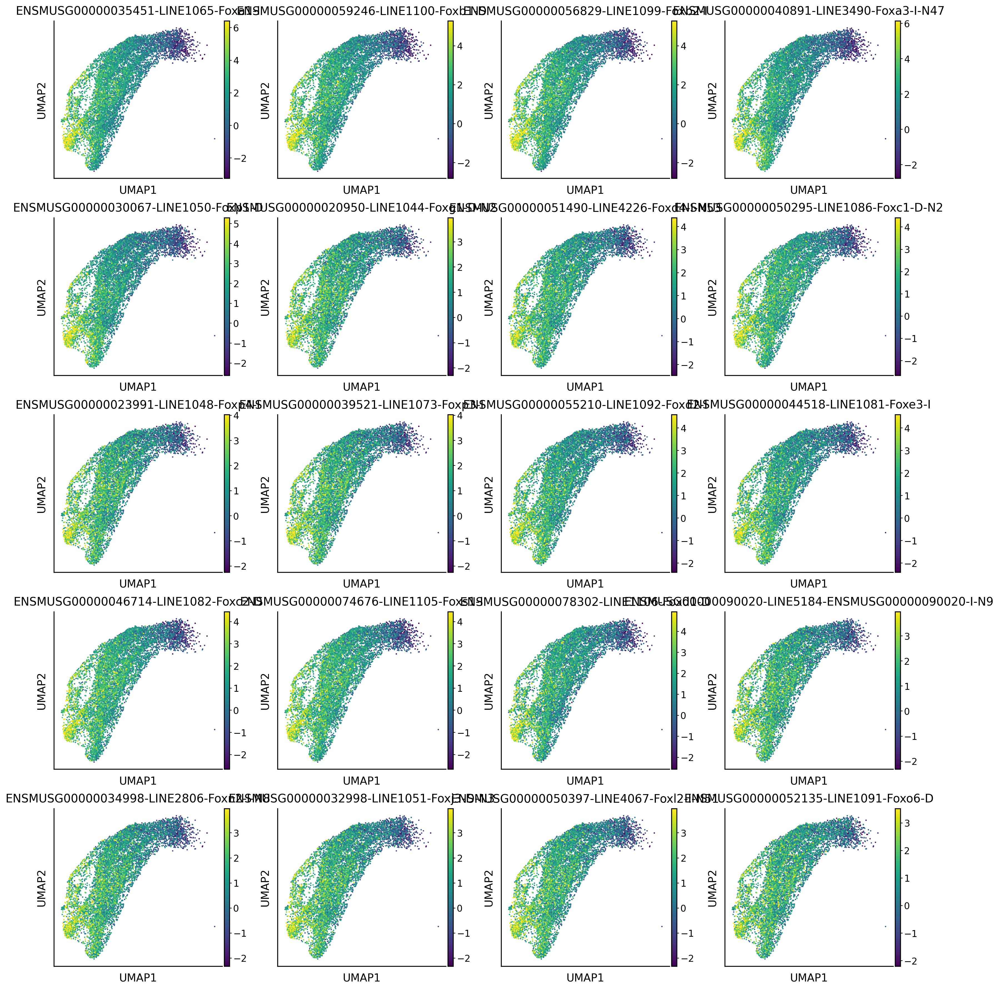

In [42]:
sc.pl.umap(tp0.adata, color=eps_drivers.index[:20], vmin="p01", vmax="p99")

In [54]:
tp0.pull(14.5, 15.5, data="refinement", subset=["Ngn3 high,0"], key_added="eps_prog")

In [55]:
eps_prog = tp0.compute_feature_correlation(obs_key="eps_prog", features=chromvar_features, annotation={"celltype": ["Ngn3 high", "Eps. progenitors"]})

In [56]:
eps_prog

,eps_prog_corr,eps_prog_pval,eps_prog_qval,eps_prog_ci_low,eps_prog_ci_high
MA1643.1,0.495999,9.212193e-266,6.872296e-263,0.472569,0.518729
MA1528.1,0.485130,4.529749e-252,1.689596e-249,0.461376,0.508188
MA1527.1,0.478629,3.824141e-244,9.509363e-242,0.454686,0.501881
MA0505.1,0.437676,2.212832e-198,3.301546e-196,0.412599,0.462090
MA1540.1,0.437181,7.184802e-198,8.933104e-196,0.412091,0.461609
...,...,...,...,...,...
MA0853.1,-0.366464,1.082593e-133,4.486746e-132,-0.392664,-0.339669
MA0703.2,-0.366798,5.886766e-134,2.583251e-132,-0.392990,-0.340011
MA0510.2,-0.375568,5.018237e-141,2.339753e-139,-0.401556,-0.348975
MA0798.2,-0.432905,1.728976e-193,1.842594e-191,-0.457448,-0.407703


In [48]:
sc.pl.umap(adata, color="Foxb2")

KeyError: 'Could not find key Foxb2 in .var_names or .obs.columns.'